# IL SISTEMA MASSA-MOLLA

Il sistema massa molla è il sistema dove un punto materiale di massa $m$ è soggetto ad una *forza elastica* che soddisfa la legge di Hooke:
$$
F = - k\, x
$$
dove $k$ è la costante elastica e si misura in N/m e $x$ è lo spostamento dalla posizione di equilibrio. La forza elastica è una forza *di richiamo*, tende cioè a riportare il sistema verso l'equilibrio. 

Dal momento che $F=ma$ per il secondo principio di Newton, e che $a=\tfrac{d^2x}{dt^2}$ possiamo scrivere:
$$
\frac{d^2}{dt^2}x(t)=-\frac{k}{m}x(t)
$$
Questa è l'*equazione differenziale* che governa il sistema massa molla. 
Ricavare la legge oraria non è immediato come nei casi del moto rettilineo uniforme o uniformemente accelerato, dove l'accelerazione è costante. In questo caso l'accelerazione dipende dalla posizione. 

Per ricavare $x(t)$ dobbiamo integrare $a(t)$, ma $a(t)$ dipende dalla stessa $x(t)$ per via della legge di Hooke. Problemi di questo tipo si risolvono grazie ad un'equazione differenziale. 

$\tfrac{d^2}{dt^2}x(t) = -x(t)$ (poniamo $k=1$, $m=1$ per semplicità) ci dice che la legge oraria del sistema massa molla è una funzione $x(t)$ tale che la derivata seconda di questa funzione coincida con il suo opposto. Solamente seni e coseni soddisfano questa proprietà. 





## Metodi numerici per la derivazione di funzioni

In [115]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

def first_derivative(f,dt=1,t_0=0,t_1=100):

    t = np.arange(t_0,t_1,dt)

    dx_dt = []
    for i in range(len(t)-1):
        dx = f(t[i+1])-f(t[i])
        dx_dt.append(dx/dt)
    

    return interp1d(t[:-1],dx_dt,fill_value="extrapolate") 


def second_derivative(f,dt=1,t_0=0,t_1=100):

    t = np.arange(t_0,t_1,dt)

    dx_dt = derivata_prima(f,dt,t_0,t_1)

    return first_derivative(dx_dt,dt,t_0,t_1)

        



In [116]:
omega = 1 #2*np.pi

def x(t):
    return np.cos(omega*t)

t = np.linspace(0.01,10,100)

v = first_derivative(x,0.1,0,10)

a = second_derivative(x,0.1,0,10)


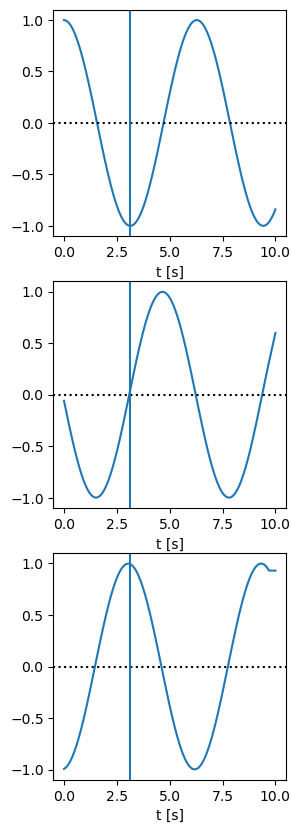

In [117]:
fig, ax = plt.subplots(3,1,figsize=(3,10))

ax[0].plot(t,x(t))
ax[1].plot(t,v(t))
ax[2].plot(t,a(t))

for i in range(3):
    ax[i].axhline(y=0,linestyle=':',color='black')
    ax[i].axvline(x=np.pi)
    ax[i].set_xlabel("t [s]")


# Metodi numerici per la risoluzione di equazioni differenziali

Noi sapevamo già che la soluzione dell'equazione differenziale $\tfrac{d^2x}{dt^2}=-kx$ è la funzione coseno (o seno, o qualsiasi loro combinazione lineare). Ma se non avessimo saputo *a priori* che la soluzione è il coseno, come avremmo fatto a trovare la legge oraria?

Quando un'equazione differenziale viene anche affiancata dalle *condizioni iniziali* (o condizioni al contorno) si dice che si ha un problema di Cauchy. Risolvere analiticamente un problema di Cauchy può non essere facile. Il computer può però aiutarci.
Risolvere un equazione differenziale 

Consideriamo un problema di Cauchy del tipo:
$$
x'(t) = f(t, x), \quad x(t_0) = x_0.
$$
I metodi numerici permettono di approssimare la soluzione in punti discreti
$$
t_n = t_0 + n h, \quad n = 0, 1, 2, \dots
$$
dove $h$ è il passo di integrazione.

1. Metodo di Eulero: È il metodo più semplice. Si calcola il valore successivo come
  $$
  x_{n+1} = x_n + h\,f(t_n, x_n).
  $$
  È un metodo esplicito di primo ordine, cioè l'errore locale è proporzionale a $h^2$ e l'errore globale a $h$.

2. Metodo del punto medio (Eulero migliorato):
  Si utilizza una stima intermedia per migliorare la precisione:
  $$
  k_1 = f(t_n, x_n), \qquad
  k_2 = f\left(t_n + \tfrac{h}{2},\,x_n + \tfrac{h}{2}k_1\right),
  $$
  e quindi
  $$
  x_{n+1} = x_n + h\,k_2.
  $$
  Questo metodo è di secondo ordine e fornisce risultati più accurati rispetto a Eulero semplice.

 Metodo di Runge–Kutta del quarto ordine (RK4):
  È uno dei metodi più usati per la sua ottima precisione e semplicità di implementazione:
  $$
  \begin{aligned}
  k_1 &= f(t_n, y_n),\\
  k_2 &= f\left(t_n + \tfrac{h}{2},\, y_n + \tfrac{h}{2}k_1\right),\\
  k_3 &= f\left(t_n + \tfrac{h}{2},\, y_n + \tfrac{h}{2}k_2\right),\\
  k_4 &= f(t_n + h,\, y_n + h\,k_3),\\
  y_{n+1} &= y_n + \tfrac{h}{6}\,(k_1 + 2k_2 + 2k_3 + k_4).
  \end{aligned}
  $$
  Il metodo è di ordine quattro, quindi molto preciso anche con passi relativamente grandi.

  \item \textbf{Metodo di Hermite (o metodo del punto medio modificato):}\\
  Questo metodo utilizza sia il valore della derivata nel punto iniziale che in quello finale stimato:
  \[
  k_1 = f(t_n, y_n), \qquad
  k_2 = f(t_n + h,\, y_n + h\,k_1),
  \]
  e la formula di aggiornamento è
  \[
  y_{n+1} = y_n + \frac{h}{2}(k_1 + k_2).
  \]
  È un metodo di secondo ordine, con un errore più contenuto rispetto a Eulero e simile a quello del punto medio.
\end{itemize}

In [111]:
time_array = np.linspace(0,100,10000)

x = [10000]
v = [0]

for i in range(1,len(time_array)):
    
    a = -9.81

    dt = time_array[i] - time_array[i-1]
    
    new_v = v[i-1] + a * dt

    new_x = x[i-1] + new_v * dt
    
    v.append(new_v)
    x.append(new_x)


In [119]:
x = [1]
v = [0]


m = 1
k = 3
gamma = 0.5

T = 2*np.pi * np.sqrt(m/k)

A_F = 1
w_F = 15

for i in range(1,len(time_array)):

    a = -(k/m) * x[i-1] 

    # moto armonico forzato smorzato
    # a -= gamma * v[i-1] + A_F * np.cos(w_F*time_array[i-1])

    # più forza costante
    # a += -9.81

    # più attrito statico 
    if v[i-1] > 1e6: #1e-6:
        if a < 1:
            a = 0
    
    dt = time_array[i] - time_array[i-1]
    
    new_v = v[i-1] + a * dt

    new_x = x[i-1] + new_v * dt
    
    v.append(new_v)
    x.append(new_x)



(0.0, 10.0)

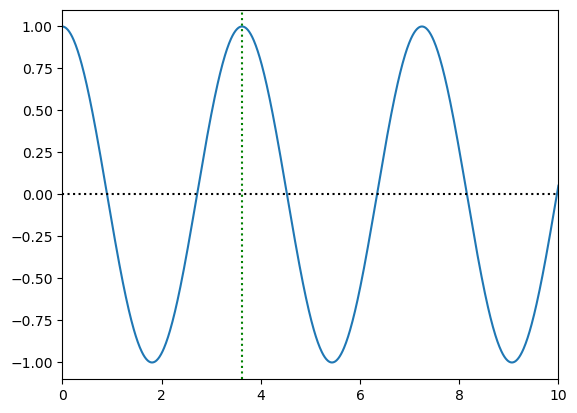

In [120]:
plt.plot(time_array,x)
plt.axhline(y=0,linestyle=':',color='black')
plt.axvline(x=T,linestyle=':',color='green')
plt.xlim(0,10)

/tmp/ipykernel_19463/3047865721.py:35: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  mass.set_data(x_pos, 0)


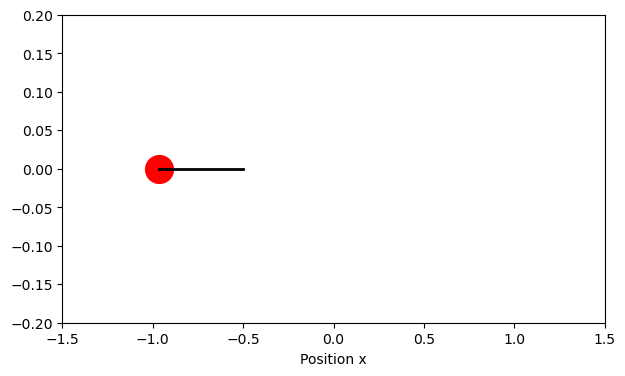

In [123]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


time_step = 0.1
time_array_anim = np.arange(time_array[0],time_array[-1],time_step)
x_anim = np.interp(time_array_anim, time_array, x)

# --- Animation setup ---
fig, ax = plt.subplots(figsize=(7, 4))

ax.set_xlim(-1.5*np.max(np.abs(x)), 1.5*np.max(np.abs(x)))
ax.set_ylim(-0.2, 0.2)
ax.set_xlabel("Position x")
#ax.set_title("Damped, Forced Oscillator")

# Fixed wall
#ax.plot([-1.5*np.max(np.abs(x)), -0.5*np.max(np.abs(x))], [0, 0], color="black", lw=4)

# Moving mass (a circle)
mass, = ax.plot([], [], 'ro', markersize=20)
# Spring (a simple line)
spring, = ax.plot([], [], 'k-', lw=2)


# --- Initialization function ---
def init():
    mass.set_data([], [])
    spring.set_data([], [])
    return mass, spring

def update(i):
    x_pos = x_anim[i]
    spring.set_data([-0.5*np.max(np.abs(x)), x_pos], [0, 0])
    mass.set_data(x_pos, 0)
    return mass, spring

# --- Create the animation ---
anim = FuncAnimation(fig, update, frames=len(time_array_for_animation), init_func=init,
                     interval=50, blit=True)

display(HTML(anim.to_jshtml()))
